Instructions:
- Perform the data exploration step (i.e. evaluate your data, # of observations, details about your data distributions, scales, missing data, column descriptions) Note: For image data you can still describe your data by the number of classes, # of images, plot example classes of the image, size of images, are sizes uniform? Do they need to be cropped? normalized? etc.
- Plot your data. For tabular data, you will need to run scatters, for image data, you will need to plot your example classes.
- How will you preprocess your data? You should explain this in your README.md file and link your Jupyter notebook to it. All code and  Jupyter notebooks have be uploaded to your repo.

In [1]:
!pip install pandas
!pip install opendatasets
!pip install Pillow

In [2]:
import opendatasets as od
import pandas as pd

od.download(
    "https://www.kaggle.com/datasets/kacpergregorowicz/house-plant-species")

Skipping, found downloaded files in "./house-plant-species" (use force=True to force download)


### Import Necessary Libraries

In [3]:
import os
from PIL import Image, ImageOps
import numpy as np
import pandas as pd
import random
from torchvision import transforms
from tqdm import tqdm
from sklearn.preprocessing import LabelEncoder
import matplotlib.pyplot as plt

#Data Exploration

### Column Descriptions

In [4]:
# Set paths
data_dir = 'house-plant-species/house_plant_species/'  # Path where images are stored in subfolders by category
output_dir = 'processed_images/'    # Directory to save processed images by category
os.makedirs(output_dir, exist_ok=True)

# Create dataframe for plant categories
# Initialize a list to hold file paths and labels
file_paths = []
labels = []

# Loop through each category folder
for category in os.listdir(data_dir):
    category_path = os.path.join(data_dir, category)

    # Check if it's a directory
    if os.path.isdir(category_path):
        for img_file in os.listdir(category_path):
            file_paths.append(os.path.join(category_path, img_file))  # Full path to the image
            labels.append(category)  # Folder name is the label

# Create the DataFrame
labels_df = pd.DataFrame({
    'file_path': file_paths,
    'species': labels
})

print(labels_df.head())

                                           file_path  \
0  house-plant-species/house_plant_species/Cast I...   
1  house-plant-species/house_plant_species/Cast I...   
2  house-plant-species/house_plant_species/Cast I...   
3  house-plant-species/house_plant_species/Cast I...   
4  house-plant-species/house_plant_species/Cast I...   

                                species  
0  Cast Iron Plant (Aspidistra elatior)  
1  Cast Iron Plant (Aspidistra elatior)  
2  Cast Iron Plant (Aspidistra elatior)  
3  Cast Iron Plant (Aspidistra elatior)  
4  Cast Iron Plant (Aspidistra elatior)  


The file_path column holds the full file path to each image in the dataset. The species column corresponds to the species of each plant image. The species names are derived from the folder name containing the image, and serves as the label.

### Attributes of Dataset

In [5]:
# Count the number of images per species
species_counts = labels_df['species'].value_counts()
print(species_counts.to_string())

# Total number of images
total_images = labels_df.shape[0]

# Total number of unique classes (species)
total_classes = labels_df['species'].nunique()

print(f"Total number of images: {total_images}")
print(f"Total number of classes (species): {total_classes}")

species
Monstera Deliciosa (Monstera deliciosa)       547
Dumb Cane (Dieffenbachia spp.)                541
Chinese evergreen (Aglaonema)                 514
Lilium (Hemerocallis)                         480
Anthurium (Anthurium andraeanum)              455
ZZ Plant (Zamioculcas zamiifolia)             438
Daffodils (Narcissus spp.)                    421
Lily of the valley (Convallaria majalis)      416
Prayer Plant (Maranta leuconeura)             400
Snake plant (Sanseviera)                      396
Peace lily                                    385
Chinese Money Plant (Pilea peperomioides)     382
Money Tree (Pachira aquatica)                 359
Jade plant (Crassula ovata)                   353
Ctenanthe                                     347
Tradescantia                                  341
Tulip                                         341
Polka Dot Plant (Hypoestes phyllostachya)     341
African Violet (Saintpaulia ionantha)         337
Elephant Ear (Alocasia spp.)              

### Check for Corrupted Files

In [6]:
def check_images(directory):
    corrupted_files = []

    for subdir, dirs, files in os.walk(directory):
        for file in files:
            if file.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp', '.gif')):
                file_path = os.path.join(subdir, file)
                # Check if the image can be opened
                try:
                    img = Image.open(file_path)
                    img.verify()  # Verify that it is, in fact, an image
                except (IOError, SyntaxError) as e:
                    corrupted_files.append(file_path)
                    print(f"Corrupted file: {file_path}")

    return corrupted_files

# Specify the root directory of your image dataset
base_dir = 'house-plant-species/house_plant_species'
corrupted = check_images(base_dir)

print("Corrupted Files:", corrupted)


Corrupted Files: []


### Image Sizes

In [7]:
def check_image_sizes(df):
    sizes = []

    # Loop through each image path in the DataFrame
    for img_path in df['file_path']:
        with Image.open(img_path) as img:
            sizes.append(img.size)  # (width, height)

    # Convert to a set to get unique sizes
    unique_sizes = set(sizes)

    if len(unique_sizes) == 1:
        print("All images are uniform in size:", unique_sizes.pop())
    else:
        print("Images have varying sizes.")
        print("Unique sizes:", unique_sizes)

# Check if images are uniform in size
check_image_sizes(labels_df)

Images have varying sizes.
Unique sizes: {(2160, 3183), (500, 435), (768, 515), (570, 759), (1687, 2362), (1200, 1600), (1076, 1305), (740, 416), (2600, 3900), (1468, 1500), (580, 580), (2820, 2820), (1284, 1599), (704, 1024), (750, 991), (1600, 1576), (446, 500), (960, 721), (1731, 1730), (767, 1080), (1120, 1576), (1600, 1167), (642, 640), (852, 895), (2375, 3000), (585, 780), (624, 1000), (1209, 1690), (1600, 1432), (1888, 2244), (2848, 4272), (900, 1200), (500, 592), (1280, 1570), (960, 842), (718, 900), (1024, 1235), (925, 884), (1600, 1288), (1355, 1600), (2048, 1149), (2024, 2024), (736, 539), (1080, 2335), (1920, 1000), (1536, 1532), (1500, 1609), (717, 1200), (2686, 4029), (1528, 1528), (994, 691), (640, 571), (750, 968), (1500, 1200), (3693, 2462), (1588, 2216), (2560, 2120), (1501, 1690), (982, 982), (818, 614), (794, 1160), (600, 800), (685, 1024), (1080, 1108), (1000, 999), (930, 1200), (6720, 4480), (184, 184), (418, 500), (744, 664), (1053, 1536), (1374, 2000), (1317, 12

### Example Classes

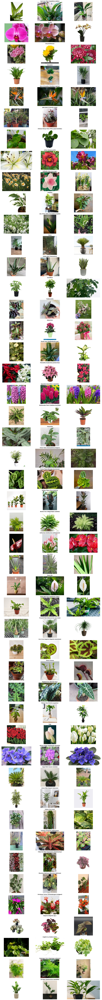

In [8]:
def plot_example_images(df, num_classes=5, images_per_class=3):
    # Select the unique species (classes) and limit to num_classes if specified
    classes = df['species'].unique()[:num_classes]

    plt.figure(figsize=(15, 3 * num_classes))  # Adjust figure size to fit the number of rows

    # Loop through each class and plot a few example images
    for i, species in enumerate(classes):
        # Filter DataFrame for the current species and get a sample of images
        sample_images = df[df['species'] == species].sample(images_per_class)['file_path']

        for j, img_path in enumerate(sample_images):
            # Calculate subplot index
            plt_idx = i * images_per_class + j + 1
            plt.subplot(num_classes, images_per_class, plt_idx)

            # Open and display the image
            img = Image.open(img_path)
            plt.imshow(img)
            plt.axis('off')

            # Add species label as title once per row
            if j == 1:
                plt.title(species, fontsize=10, fontweight='bold')

    plt.tight_layout()
    plt.show()

# Plot 3 images for each of the example classes (adjust num_classes as needed)
plot_example_images(labels_df, num_classes=47, images_per_class=3)

## EDA

# Preprocessing Images

### Remove Corrupted Images

In [9]:
def remove_corrupted_images(data_dir):
    for category in os.listdir(data_dir):
        category_path = os.path.join(data_dir, category)
        if os.path.isdir(category_path):
            for img_file in tqdm(os.listdir(category_path)):
                img_path = os.path.join(category_path, img_file)
                try:
                    with Image.open(img_path) as img:
                        img.verify()  # Check if the image can be opened
                except (IOError, SyntaxError):
                    os.remove(img_path)
                    print(f'Removed corrupted image: {img_file} in {category} folder')

remove_corrupted_images(data_dir)

100%|██████████| 438/438 [00:00<00:00, 2239.62it/s]


### Resize Images and Convert to a Consistent Format

In [10]:
# Check to see what image types we have in the original data
image_types = set()

# Traverse each subfolder and collect unique file extensions
for root, _, files in os.walk(data_dir):
    for file in files:
        # Get the file extension
        ext = os.path.splitext(file)[1].lower()  # Convert to lowercase for consistency
        image_types.add(ext)

print("Unique image types in the dataset:", image_types)

Unique image types in the dataset: {'.jfif', '.jpe', '.png', '.gif', '.webp', '.jpg', '.jpeg'}


In [11]:
def resize(data_dir, output_dir, size=(224, 224), format='JPEG'):
    accepted_types = {'.jpg', '.jpe', '.gif', '.jpeg', '.jfif', '.png', '.webp'}

    for category in os.listdir(data_dir):
        category_path = os.path.join(data_dir, category)
        output_category_path = os.path.join(output_dir, category)
        os.makedirs(output_category_path, exist_ok=True)

        if os.path.isdir(category_path):
            for img_file in tqdm(os.listdir(category_path)):
                ext = os.path.splitext(img_file)[1].lower()

                if ext in accepted_types:
                    img_path = os.path.join(category_path, img_file)
                    output_path = os.path.join(output_category_path, img_file.split('.')[0] + '.jpg')

                    try:
                        with Image.open(img_path) as img:
                            # Convert palette images with transparency to RGBA first
                            if img.mode == 'P' or img.mode == 'RGBA':
                                img = img.convert('RGBA')

                            # Resize
                            img = ImageOps.fit(img, size, Image.LANCZOS).convert('RGB')
                            img.save(output_path, format=format)
                    except Exception as e:
                        print(f'Error processing {img_file} in {category} folder: {e}')

resize(data_dir, output_dir)

100%|██████████| 438/438 [00:25<00:00, 17.15it/s]


In [12]:
# # Zip the output directory and download locally
# import shutil
# # from google.colab import files

# # Path to the output directory where resized images are saved
# output_dir = 'output_images'  # Replace with your output directory
# zip_file = 'resized_images.zip'

# # Compress the output directory into a zip file
# shutil.make_archive('resized_images', 'zip', output_dir)

# # Download the zip file to your local machine
# files.download('resized_images.zip')

### Label Encoding the Categories

In [13]:
# Get unique categories
category_labels = labels_df['species'].unique()
print("Category Labels:", category_labels)
print("Number of Categories:", len(category_labels))

Category Labels: ['Cast Iron Plant (Aspidistra elatior)' 'Orchid' 'Chrysanthemum'
 'Dracaena' 'Bird of Paradise (Strelitzia reginae)'
 'Jade plant (Crassula ovata)' 'Chinese Money Plant (Pilea peperomioides)'
 'Lilium (Hemerocallis)' 'Daffodils (Narcissus spp.)' 'Calathea'
 'Lily of the valley (Convallaria majalis)' 'Yucca'
 'Snake plant (Sanseviera)' 'Schefflera' 'Tradescantia' 'Kalanchoe'
 'Dumb Cane (Dieffenbachia spp.)' 'Poinsettia (Euphorbia pulcherrima)'
 'Hyacinth (Hyacinthus orientalis)'
 'Rattlesnake Plant (Calathea lancifolia)' 'Ctenanthe'
 'Parlor Palm (Chamaedorea elegans)' 'Prayer Plant (Maranta leuconeura)'
 'Rubber Plant (Ficus elastica)' 'Boston Fern (Nephrolepis exaltata)'
 'Anthurium (Anthurium andraeanum)' 'Aloe Vera' 'Peace lily'
 'Birds Nest Fern (Asplenium nidus)'
 'Ponytail Palm (Beaucarnea recurvata)'
 'Iron Cross begonia (Begonia masoniana)' 'Venus Flytrap'
 'Elephant Ear (Alocasia spp.)' 'Money Tree (Pachira aquatica)' 'Tulip'
 'African Violet (Saintpaulia ion

In [14]:
# Save labels_df to csv for later use
labels_df.to_csv('labels_df.csv', index=False)

### Label Encoding and One-Hot Encoding
We have two encoding functions that we can use. Label-encoding is more general, but one-hot is more commonly used for non-ordinal categories. However, because we have 47 classes, one-hot encoding would be computationally more expensive and may lead to the curse of dimensionality.

In [15]:
# Label Encoding
label_encoder = LabelEncoder()

# Fit the encoder and transform the species column
labels_df['encoded_label'] = label_encoder.fit_transform(labels_df['species'])

# Display the mapping of labels to integers
label_mapping = dict(zip(label_encoder.classes_, label_encoder.transform(label_encoder.classes_)))
print("Label Encoding Mapping:", label_mapping)

labels_df['encoded_label']

Label Encoding Mapping: {'African Violet (Saintpaulia ionantha)': 0, 'Aloe Vera': 1, 'Anthurium (Anthurium andraeanum)': 2, 'Areca Palm (Dypsis lutescens)': 3, 'Asparagus Fern (Asparagus setaceus)': 4, 'Begonia (Begonia spp.)': 5, 'Bird of Paradise (Strelitzia reginae)': 6, 'Birds Nest Fern (Asplenium nidus)': 7, 'Boston Fern (Nephrolepis exaltata)': 8, 'Calathea': 9, 'Cast Iron Plant (Aspidistra elatior)': 10, 'Chinese Money Plant (Pilea peperomioides)': 11, 'Chinese evergreen (Aglaonema)': 12, 'Christmas Cactus (Schlumbergera bridgesii)': 13, 'Chrysanthemum': 14, 'Ctenanthe': 15, 'Daffodils (Narcissus spp.)': 16, 'Dracaena': 17, 'Dumb Cane (Dieffenbachia spp.)': 18, 'Elephant Ear (Alocasia spp.)': 19, 'English Ivy (Hedera helix)': 20, 'Hyacinth (Hyacinthus orientalis)': 21, 'Iron Cross begonia (Begonia masoniana)': 22, 'Jade plant (Crassula ovata)': 23, 'Kalanchoe': 24, 'Lilium (Hemerocallis)': 25, 'Lily of the valley (Convallaria majalis)': 26, 'Money Tree (Pachira aquatica)': 27, '

,encoded_label
0,10
1,10
2,10
3,10
4,10
...,...
14785,46
14786,46
14787,46
14788,46


In [16]:
# Save the label encodings
label_mapping = {key: int(value) for key, value in label_mapping.items()}

# Save the label mapping for reference
import json
with open('label_mapping.json', 'w') as f:
    json.dump(label_mapping, f)


In [17]:
# One-Hot Encoding
one_hot_labels = pd.get_dummies(labels_df['species'], prefix='species')

# Concatenate the one-hot encoded columns back to the original DataFrame
labels_df = pd.concat([labels_df, one_hot_labels], axis=1)

# Drop the original 'species' column if it’s no longer needed
labels_df = labels_df.drop('species', axis=1)

# Display the result
labels_df.head()

,file_path,encoded_label,species_African Violet (Saintpaulia ionantha),species_Aloe Vera,species_Anthurium (Anthurium andraeanum),species_Areca Palm (Dypsis lutescens),species_Asparagus Fern (Asparagus setaceus),species_Begonia (Begonia spp.),species_Bird of Paradise (Strelitzia reginae),species_Birds Nest Fern (Asplenium nidus),...,species_Rattlesnake Plant (Calathea lancifolia),species_Rubber Plant (Ficus elastica),species_Sago Palm (Cycas revoluta),species_Schefflera,species_Snake plant (Sanseviera),species_Tradescantia,species_Tulip,species_Venus Flytrap,species_Yucca,species_ZZ Plant (Zamioculcas zamiifolia)
0,house-plant-species/house_plant_species/Cast I...,10,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
1,house-plant-species/house_plant_species/Cast I...,10,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
2,house-plant-species/house_plant_species/Cast I...,10,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
3,house-plant-species/house_plant_species/Cast I...,10,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
4,house-plant-species/house_plant_species/Cast I...,10,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False


In [18]:
# Save the one-hot encodings
labels_df.to_csv('one_hot_encoded_labels.csv', index=False)

In [19]:
import os
import shutil
from sklearn.model_selection import train_test_split

ROOT_DIR = 'processed_images'
TRAIN_DIR = 'images_train'
VAL_DIR = 'images_val'
TEST_DIR = 'images_test'
SPLIT_RATIO = 0.2
TEST_RATIO = 0.15
VAL_RATIO = 0.1765
RANDOM_STATE = 42

os.makedirs(TRAIN_DIR, exist_ok=True)
os.makedirs(VAL_DIR, exist_ok=True)
os.makedirs(TEST_DIR, exist_ok=True)

for class_name in os.listdir(ROOT_DIR):
    class_path = os.path.join(ROOT_DIR, class_name)
    if os.path.isdir(class_path):
        if ".DS_Store" in class_path:
            continue

        images = os.listdir(class_path) # gets all images in class

        train_val_images, test_images = train_test_split(images, test_size=TEST_RATIO, random_state=RANDOM_STATE)
        train_images, val_images = train_test_split(train_val_images, test_size=VAL_RATIO, random_state=RANDOM_STATE)

        train_class_dir = os.path.join(TRAIN_DIR, class_name)
        val_class_dir = os.path.join(VAL_DIR, class_name)
        test_class_dir = os.path.join(TEST_DIR, class_name)
        os.makedirs(train_class_dir, exist_ok=True)
        os.makedirs(val_class_dir, exist_ok=True)
        os.makedirs(test_class_dir, exist_ok=True)

        # Copy train images
        for img_name in train_images:
            shutil.copy(os.path.join(class_path, img_name), os.path.join(train_class_dir, img_name))

        # Copy validation images
        for img_name in val_images:
            shutil.copy(os.path.join(class_path, img_name), os.path.join(val_class_dir, img_name))

        # Copy test images
        for img_name in test_images:
            shutil.copy(os.path.join(class_path, img_name), os.path.join(test_class_dir, img_name))

In [20]:
import torch
from torch.utils.data import DataLoader, random_split
from torchvision import datasets, transforms
import torch.nn as nn
import torch.nn.functional as F

dataset = datasets.ImageFolder(root=data_dir)

num_classes = len(dataset.classes)

In [21]:
transform = transforms.Compose([
    transforms.Resize((224, 224)),                # Resize to the desired size
    transforms.ToTensor(),                        # Convert PIL Image to Tensor
    transforms.Normalize((0.5,), (0.5,)),         # Normalize (mean=0.5, std=0.5 for grayscale)
])

In [22]:
train_dataset = datasets.ImageFolder(root=TRAIN_DIR, transform=transform)
val_dataset = datasets.ImageFolder(root=VAL_DIR, transform=transform)
test_dataset = datasets.ImageFolder(root=TEST_DIR, transform=transform)
train_loader = DataLoader(train_dataset, batch_size=64, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=64, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=64, shuffle=False)

In [23]:
def train(model, train_loader, criterion, optimizer, device):
    model.train()
    running_loss = 0.0
    for batch_idx, (images, labels) in enumerate(train_loader):
        images, labels = images.to(device), labels.to(device)

        # Forward pass
        outputs = model(images)
        loss = criterion(outputs, labels)

        # Backward pass and optimization
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        running_loss += loss.item() * images.size(0)

        # Print progress every few batches
        if batch_idx % 10 == 0:
            print(f"Batch {batch_idx}/{len(train_loader)}, Loss: {loss.item():.4f}")

    return running_loss / len(train_loader.dataset)


def evaluate(model, test_loader, criterion, device):
    model.eval()
    correct = 0
    total = 0
    total_loss = 0.0
    with torch.no_grad():
        for images, labels in test_loader:
            images, labels = images.to(device), labels.to(device)
            outputs = model(images)
            loss = criterion(outputs, labels) # calculate loss
            total_loss += loss.item() * images.size(0)
            _, predicted = torch.max(outputs, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()
    avg_loss = total_loss / len(test_loader.dataset)
    accuracy = correct / total
    return accuracy, avg_loss

In [24]:
import torch.nn as nn
import torch.nn.functional as F

class PlantClassifierCNN(nn.Module):
    def __init__(self, num_classes):
        super(PlantClassifierCNN, self).__init__()
        # Define layers of the CNN
        self.conv1 = nn.Conv2d(3, 32, kernel_size=3, stride=1, padding=1)  # 3 input channels for RGB
        self.conv2 = nn.Conv2d(32, 64, kernel_size=3, stride=1, padding=1)
        self.conv3 = nn.Conv2d(64, 128, kernel_size=3, stride=1, padding=1) # New layer for MS4
        self.pool = nn.MaxPool2d(kernel_size=2, stride=2)
        self.fc1 = nn.Linear(128 * 28 * 28, 256)  # Adjusted from 64 * 56 * 56, 128
        self.fc2 = nn.Linear(256, num_classes) # Adjusted from 128

    def forward(self, x):
        x = self.pool(F.relu(self.conv1(x)))
        x = self.pool(F.relu(self.conv2(x)))
        x = self.pool(F.relu(self.conv3(x))) # New pooling layer for MS4
        x = x.view(-1, 128 * 28 * 28)  # Adjusted from -1, 64 * 56 * 56
        x = F.relu(self.fc1(x))
        x = self.fc2(x)
        return x

# Initialize model, loss function, and optimizer
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = PlantClassifierCNN(num_classes=num_classes).to(device)
criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)

In [25]:
num_epochs = 3 # Added another epoch

for epoch in range(num_epochs):
    train_loss = train(model, train_loader, criterion, optimizer, device)
    test_accuracy, test_loss = evaluate(model, test_loader, criterion, device)
    print(f"Epoch [{epoch+1}/{num_epochs}], Loss: {train_loss:.4f}, Test Accuracy: {test_accuracy:.4f}, Test Loss: {test_loss:.4f}", flush=True)

Batch 0/162, Loss: 3.8554
Batch 10/162, Loss: 3.7721
Batch 20/162, Loss: 3.6168
Batch 30/162, Loss: 3.6175
Batch 40/162, Loss: 3.5633
Batch 50/162, Loss: 3.3274
Batch 60/162, Loss: 3.4432
Batch 70/162, Loss: 3.3731
Batch 80/162, Loss: 3.5466
Batch 90/162, Loss: 3.1684
Batch 100/162, Loss: 3.2056
Batch 110/162, Loss: 2.9113
Batch 120/162, Loss: 3.1399
Batch 130/162, Loss: 2.9681
Batch 140/162, Loss: 3.1083
Batch 150/162, Loss: 2.9249
Batch 160/162, Loss: 3.0170
Epoch [1/3], Loss: 3.3034, Test Accuracy: 0.2258, Test Loss: 2.9021
Batch 0/162, Loss: 2.7079
Batch 10/162, Loss: 3.0537
Batch 20/162, Loss: 2.7107
Batch 30/162, Loss: 3.1380
Batch 40/162, Loss: 2.8134
Batch 50/162, Loss: 2.5796
Batch 60/162, Loss: 2.6129
Batch 70/162, Loss: 2.6030
Batch 80/162, Loss: 3.3241
Batch 90/162, Loss: 2.7266
Batch 100/162, Loss: 2.3393
Batch 110/162, Loss: 2.7718
Batch 120/162, Loss: 2.2484
Batch 130/162, Loss: 2.5518
Batch 140/162, Loss: 2.1415
Batch 150/162, Loss: 2.8551
Batch 160/162, Loss: 2.2899
Ep

In [28]:
test_accuracy = evaluate(model, test_loader, criterion, device)

In [29]:
test_accuracy

(0.36189201249442216, 2.344492877928714)

In [30]:
train_accuracy = evaluate(model, train_loader, criterion, device)
train_accuracy

(0.6693180715879329, 1.2513017077279005)

In [32]:
validation_accuracy = evaluate(model, val_loader, criterion, device)
validation_accuracy

(0.35892857142857143, 2.37579744883946)